In [1]:
import emat
emat.versions()

emat 0.6.4, plotly 5.24.1


# Scatter Plot Matrix

Once a series of experiments has been conducted for a core model, it
is suggested that an analyst review the results to confirm that the 
model is behaving as expected.  TMIP-EMAT provides some visualization
tools to review results in a graphical manner, which is a generally 
convenient method to review this experimental data.

To demonstrate these tools, we will use the Road Test example model included
in TMIP-EMAT.  We can quickly construct and run a design of experiments
to exercise this model and populate some results to visualize:

In [2]:
import emat.examples
scope, db, model = emat.examples.road_test()
design = model.design_experiments()
results = model.run_experiments(design)

Given this set of experimental results, we can display a scatter plot matrix
to see the results.  This is a collection of two-dimensional plots, each
showing a contrast between two factors, typically an input parameter (i.e. 
an uncertainty or a policy lever) and an output performance measure, although
it is also possible to plot inputs against inputs or outputs against outputs.

The `display_experiments` function in the `emat.analysis` sub-package can 
automatically create a scatter plot matrix that crosses every parameter with
every measure, simply by providing the scope and the results.  By default, 
plots that display levers are shown in blue, plots that show uncertainties
are in red. 

No Build Time

<xmle.Elem 'img' with 0 children>
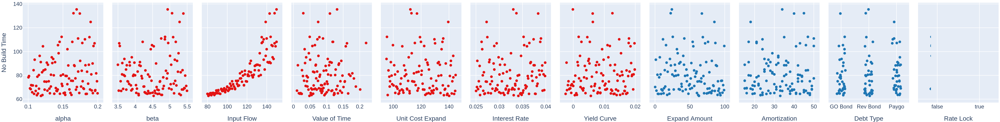

Build Time

<xmle.Elem 'img' with 0 children>
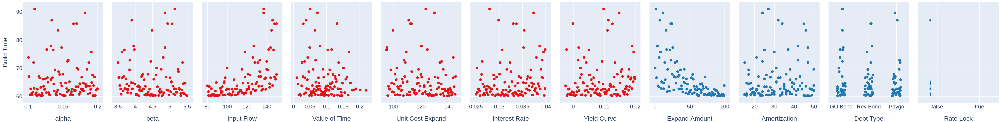

Time Savings

<xmle.Elem 'img' with 0 children>
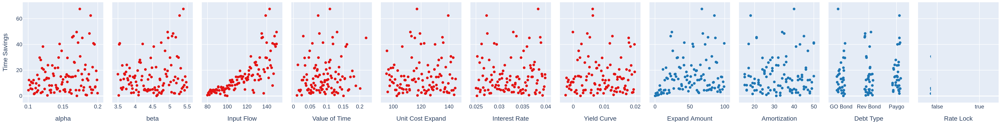

Value Time Save

<xmle.Elem 'img' with 0 children>
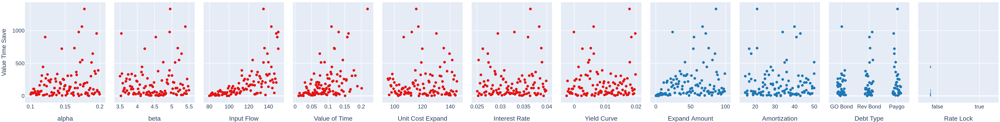

Net Benefits

<xmle.Elem 'img' with 0 children>
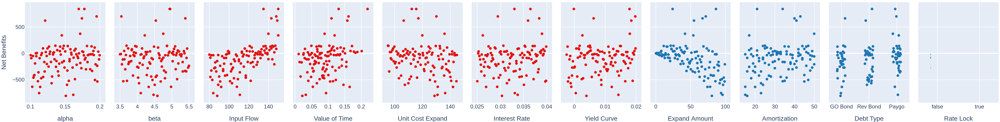

Cost of Expand

<xmle.Elem 'img' with 0 children>
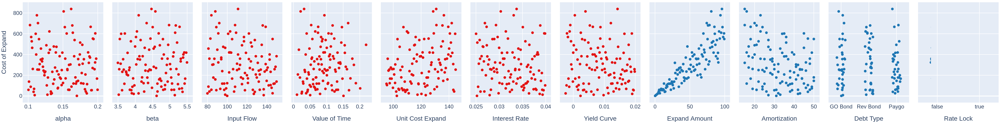

Present Cost

<xmle.Elem 'img' with 0 children>
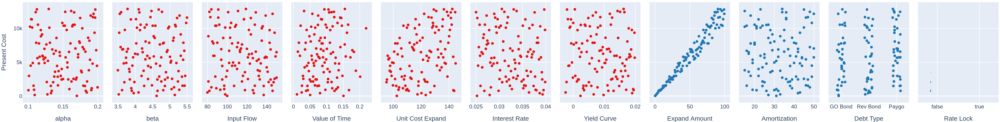

In [3]:
from emat.analysis import display_experiments
display_experiments(scope, results)

This function also offers the opportunity to identify only a particular 
subset of parameters or measures to display, using the `rows` and `columns` 
arguments.  Similar colors are used as the default full display, although
if the plot contrasts an uncertainty with a lever the variable on the 
X axis determines the color; and the plot is green if only measures are shown.
Because parameters and measures
are all required to have unique names within a scope, it is not necessary
to identify which is which, as the `display_experiments` can figure it out
automatically.

Input Flow

<xmle.Elem 'img' with 0 children>
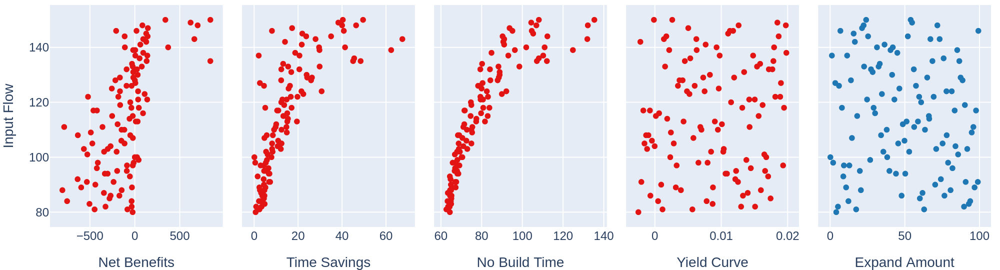

Expand Amount

<xmle.Elem 'img' with 0 children>
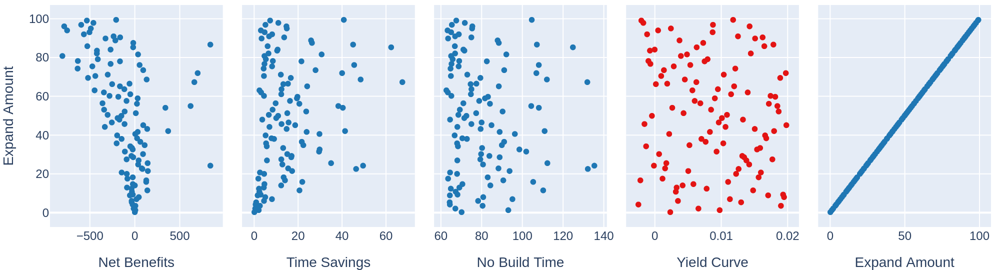

Build Time

<xmle.Elem 'img' with 0 children>
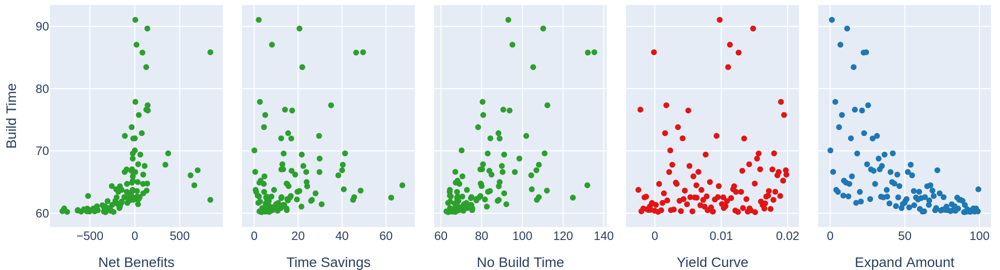

In [4]:
display_experiments(
    scope, results, 
    rows=['input_flow', 'expand_capacity', 'build_travel_time'], 
    columns=['net_benefits', 'time_savings', 'no_build_travel_time', 'yield_curve', 'expand_capacity'],
)

Reviewing these results can be instructive, not only for exploratory analysis
but also for validation of the results from the core model.  An analyst can
quickly see the direction, magnitude, and shape of various parametric relationships
in the model, and easily detect any parameters that are giving unexpected results.
For example, in many transportation modeling applications we would expect that
most parameters will induce a monotonic response in most performance measures.
Observing non-monotonic relationships where we don't expect them is a red flag for
the analyst to closely review model outputs, and perhaps the underlying model
coding as well, to identify and correct errors. 

## Contrasting Sets of Experiments

A similar set of visualizations can be created to contrast two set
of experiments derived from the same (or substantially similar) scopes.
This is particularly valuable to evaluate the performance of meta-models
that are derived from core models, as we can generate scatter plot
matrices that show experiments from both the core and meta models.

To demonstrate this capability, we'll first create a meta-model from
the Road Test core model, then apply that meta-model to a design of
5,000 experiments to create a set of meta-model results to visualize.

In [5]:
mm = model.create_metamodel_from_design('lhs', suppress_converge_warnings=True)
mm_design = mm.design_experiments(n_samples=5000)
mm_results = mm.run_experiments(mm_design)

/home/runner/work/tmip-emat/tmip-emat/emat/database/sqlite/sqlite_db.py:1822: FutureWarning:

In a future version of pandas all arguments of MultiIndex.set_levels except for the argument 'levels' will be keyword-only



The `contrast_experiments` function in the `emat.analysis` sub-package can 
automatically create a scatter plot matrix, using a very similar interface
to the `display_experiments` function.  The primary difference between these 
two functions is that `contrast_experiments` takes two sets of experiments
as arguments, instead of one.  The resulting plots are also not colorized
based on the roles of each factor in the scope; instead colors are used
to differentiate the different datasets.

No Build Time

<xmle.Elem 'img' with 0 children>
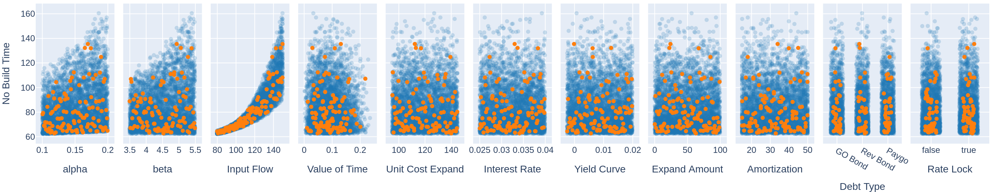

Build Time

<xmle.Elem 'img' with 0 children>
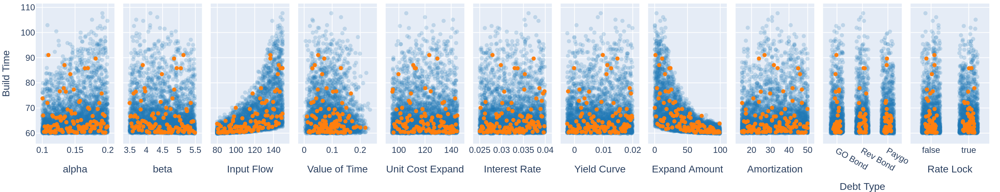

Time Savings

<xmle.Elem 'img' with 0 children>
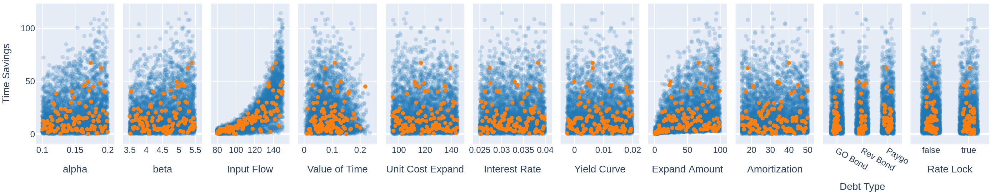

Value Time Save

<xmle.Elem 'img' with 0 children>
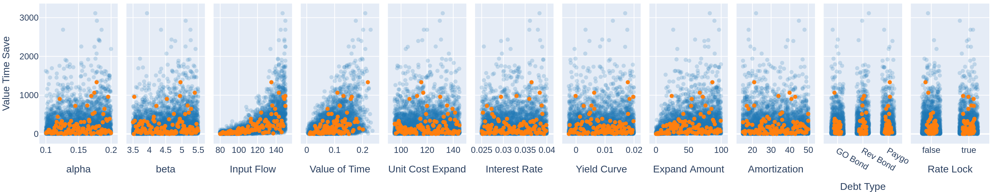

Net Benefits

<xmle.Elem 'img' with 0 children>
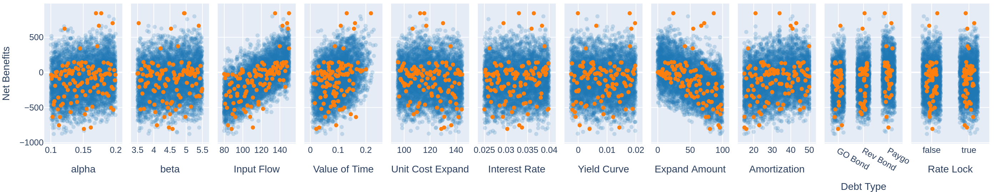

Cost of Expand

<xmle.Elem 'img' with 0 children>
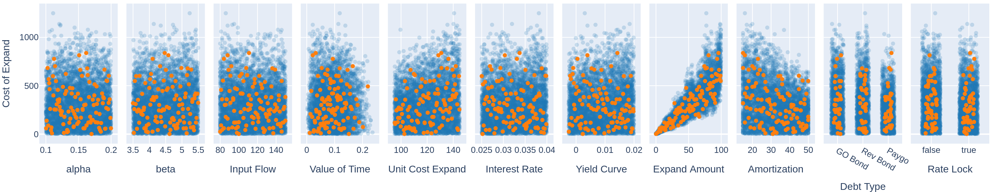

Present Cost

<xmle.Elem 'img' with 0 children>
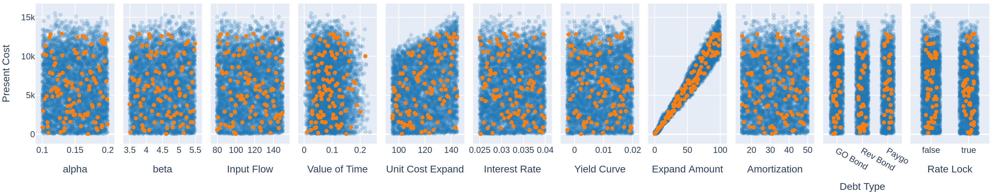

In [6]:
from emat.analysis import contrast_experiments
contrast_experiments(scope, mm_results, results)